In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import cv2
import os

def extract_frames(video_path, output_path, frames_per_second):
    # Create output directory if it doesn't exist
    os.makedirs(output_path, exist_ok=True)

    # Open the video file
    video_capture = cv2.VideoCapture(video_path)

    # Get frames per second (fps) of input video
    fps = video_capture.get(cv2.CAP_PROP_FPS)

    # Calculate the interval between frames to achieve the desired frames_per_second
    frame_interval = int(fps / frames_per_second)

    # Initialize frame count
    frame_count = 0

    while True:
        # Read the next frame
        ret, frame = video_capture.read()

        # Break the loop if no more frames are available
        if not ret:
            break

        # Check if the current frame should be saved
        if frame_count % frame_interval == 0:
            # Save the frame
            frame_filename = os.path.join(output_path, f"frame_{frame_count // frame_interval}.png")
            cv2.imwrite(frame_filename, frame)

        # Increment frame count
        frame_count += 1

        # Stop after getting the desired number of frames
        if frame_count == int(frames_per_second * video_capture.get(cv2.CAP_PROP_POS_MSEC) / 1000):
            break

    # Release the video capture object
    video_capture.release()

# Specify the path to your video file
video_path = 'drive/My Drive/Colab Notebooks/CV proj/Video 1.mp4'

# Specify the output path where frames will be saved
output_path = 'drive/My Drive/Colab Notebooks/CV proj/framef'

# Specify the desired frames per second
frames_per_second = 17

# Call the function to extract frames
extract_frames(video_path, output_path, frames_per_second)

In [2]:
from IPython.display import HTML
from base64 import b64encode
from PIL import Image
from torchvision import transforms

In [3]:
import os, sys
import numpy as np
import cv2
import pickle
from IPython.display import clear_output
import matplotlib.pyplot as plt
from tqdm import tqdm

# from transformers import AutoProcessor, CLIPSegForImageSegmentation
import torchvision
import torch

from google.colab.patches import cv2_imshow
from google.colab import drive
from glob import glob

# import evaluate

In [ ]:
!git clone https://github.com/hustvl/YOLOP.git
%cd YOLOP

# Install dependencies
!pip install -r requirements.txt


Cloning into 'YOLOP'...
remote: Enumerating objects: 431, done.
remote: Counting objects: 100% (426/426), done.
remote: Compressing objects: 100% (233/233), done.
remote: Total 431 (delta 212), reused 334 (delta 184), pack-reused 5
Receiving objects: 100% (431/431), 140.17 MiB | 29.53 MiB/s, done.
Resolving deltas: 100% (212/212), done.
Updating files: 100% (95/95), done.
/content/YOLOP/YOLOP


In [ ]:
import torch.backends.cudnn as cudnn
from numpy import random
import scipy.special
import numpy as np
import torchvision.transforms as transforms
import PIL.Image as image

from lib.config import cfg
from lib.config import update_config
from lib.utils.utils import create_logger, select_device, time_synchronized
from lib.models import get_net
from lib.dataset import LoadImages, LoadStreams
from lib.core.general import non_max_suppression, scale_coords
from lib.utils import plot_one_box,show_seg_result
from lib.core.function import AverageMeter
from lib.core.postprocess import morphological_process, connect_lane
from tqdm import tqdm

INFO:root:Using torch 2.1.0+cu118 CPU
Using torch 2.1.0+cu118 CPU
INFO:root:



=> creating runs/BddDataset/_2023-12-04-14-02


  0%|          | 0/749 [00:00<?, ?it/s]

image 1/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_0.png: 


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


(362, 640) (362, 640, 3)


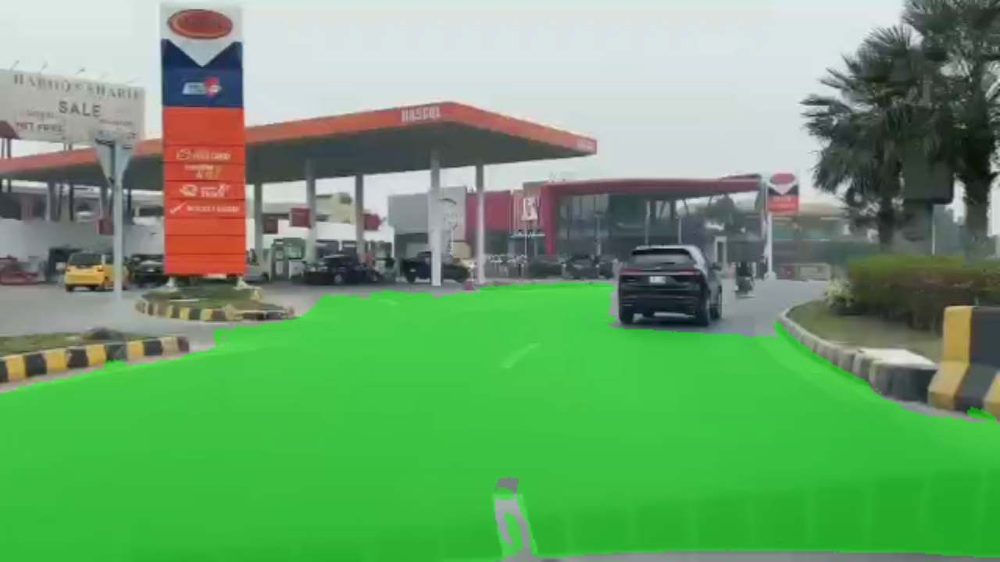

  0%|          | 1/749 [00:06<1:22:51,  6.65s/it]

image 2/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_1.png: 
(362, 640) (362, 640, 3)


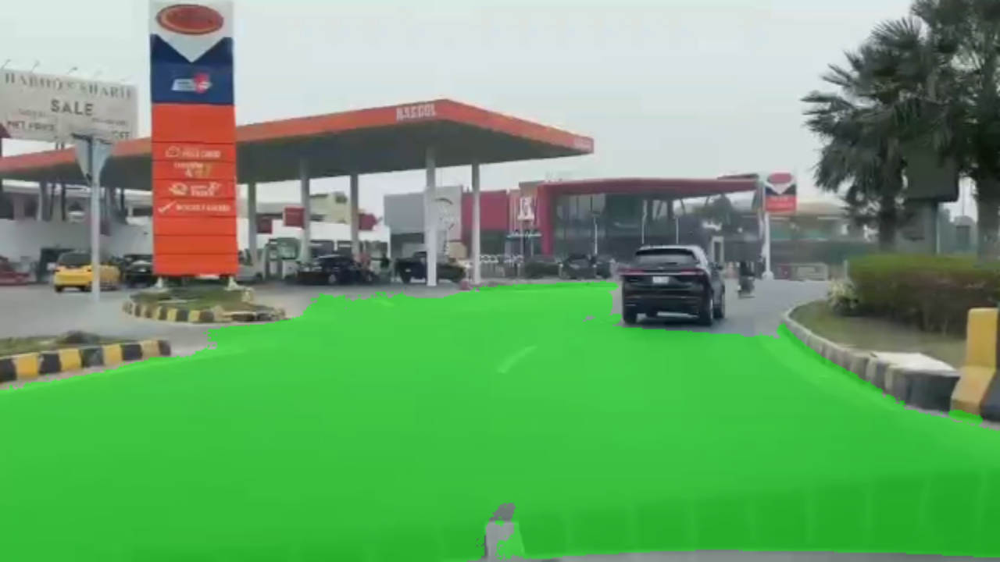

  0%|          | 2/749 [00:10<59:46,  4.80s/it]  

image 3/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_10.png: 
(362, 640) (362, 640, 3)


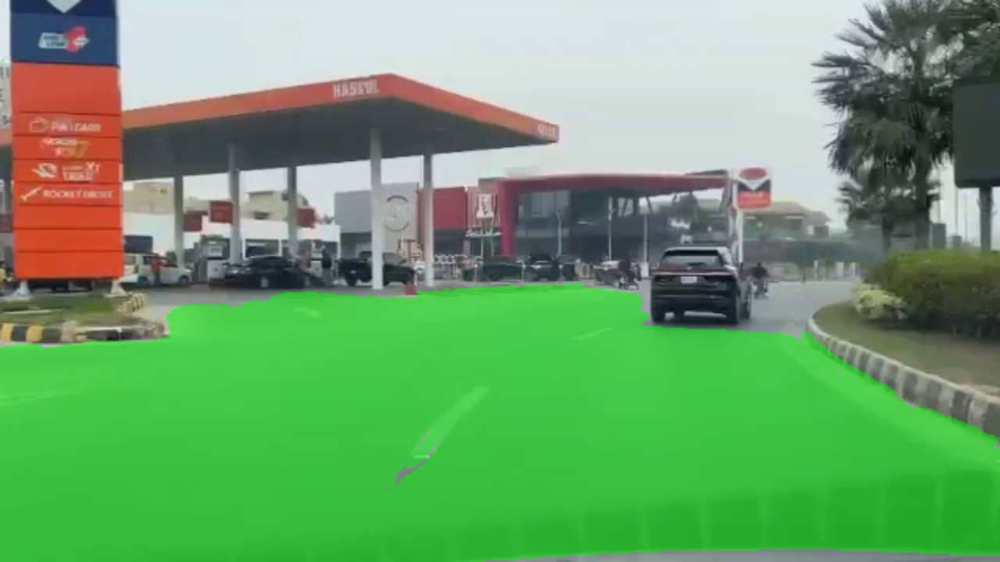

  0%|          | 3/749 [00:13<49:45,  4.00s/it]

image 4/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_100.png: 
(362, 640) (362, 640, 3)


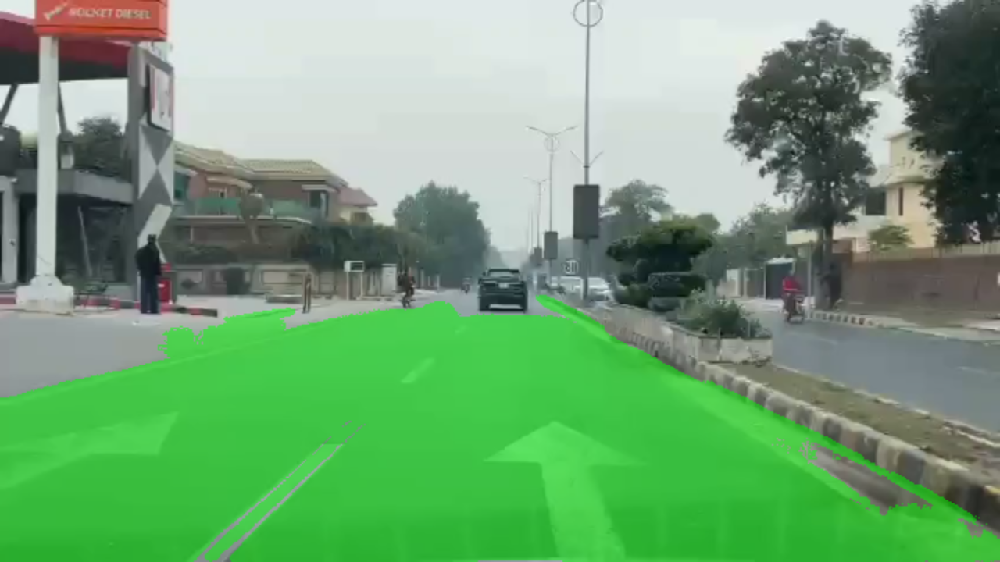

  1%|          | 4/749 [00:15<42:14,  3.40s/it]

image 5/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_101.png: 
(362, 640) (362, 640, 3)


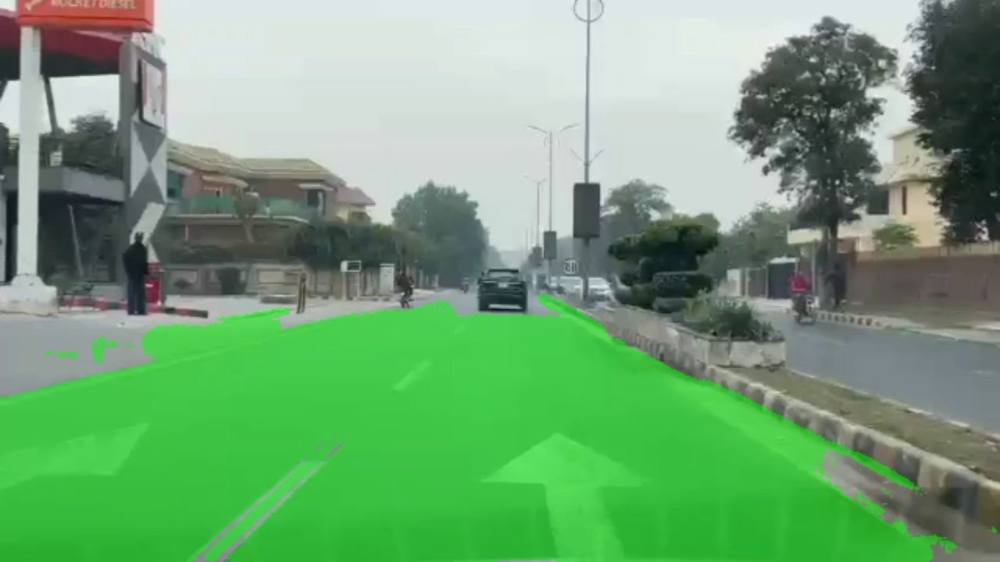

  1%|          | 5/749 [00:20<48:19,  3.90s/it]

image 6/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_102.png: 
(362, 640) (362, 640, 3)


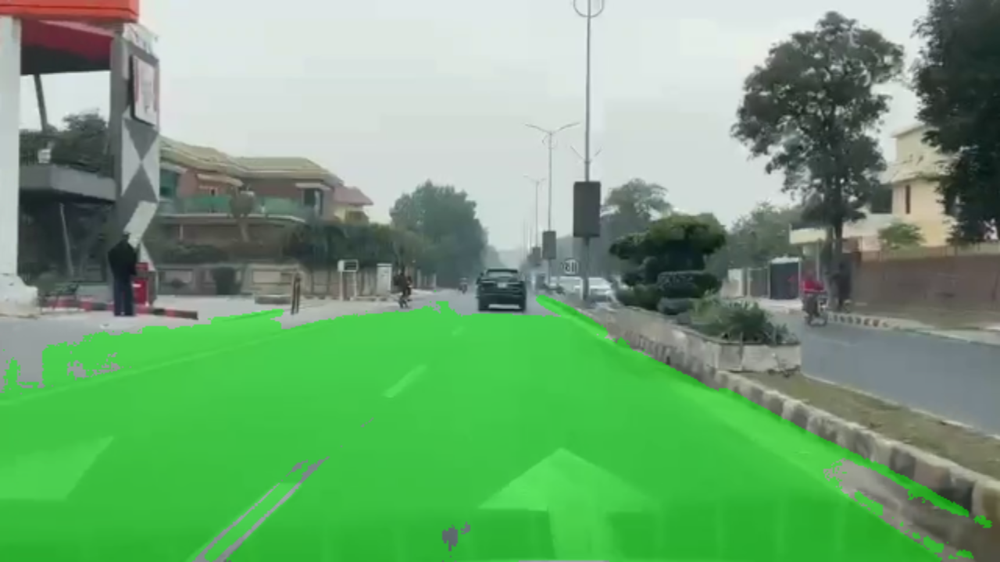

  1%|          | 6/749 [00:22<40:38,  3.28s/it]

image 7/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_103.png: 
(362, 640) (362, 640, 3)


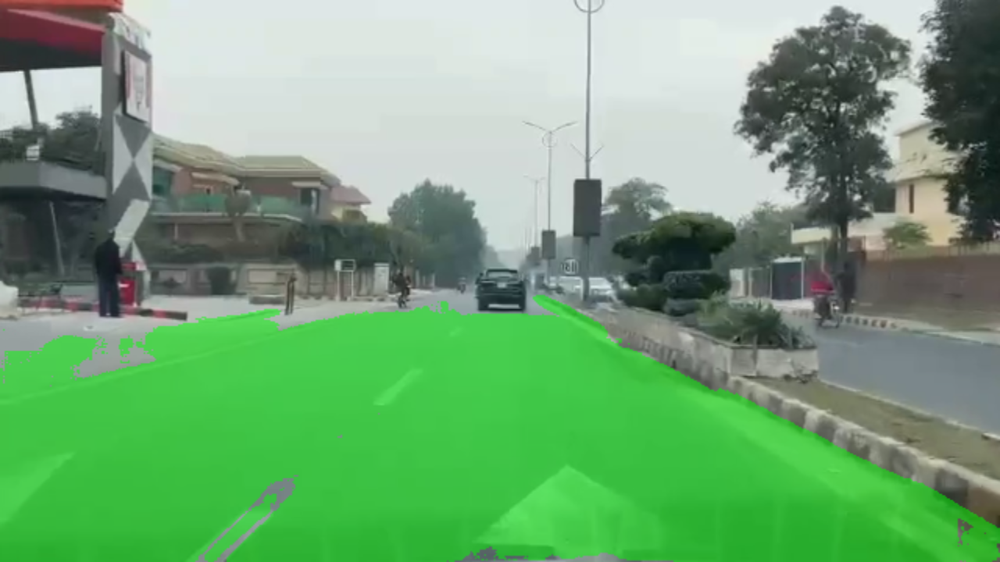

  1%|          | 7/749 [00:24<35:34,  2.88s/it]

image 8/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_104.png: 
(362, 640) (362, 640, 3)


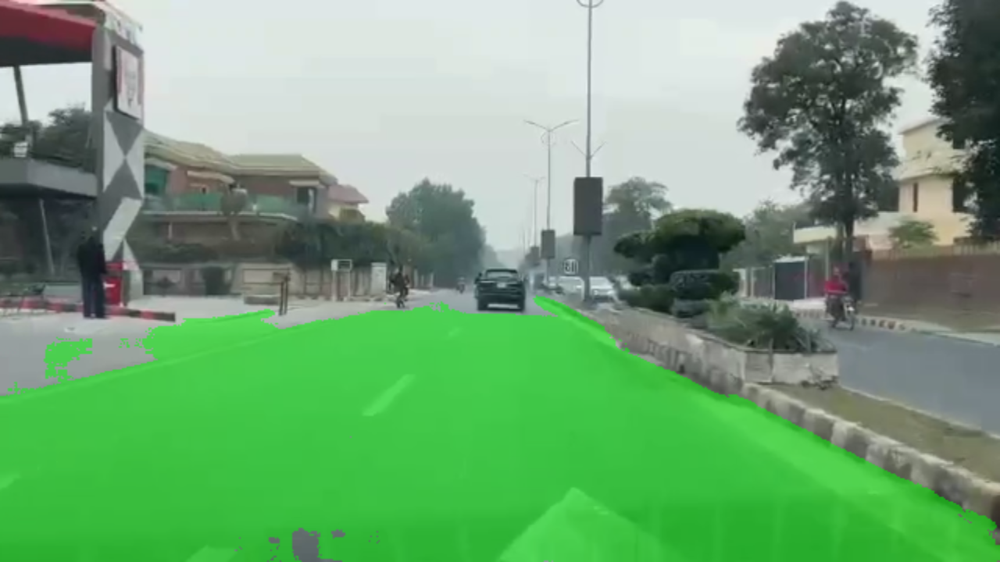

  1%|          | 8/749 [00:26<32:27,  2.63s/it]

image 9/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_105.png: 
(362, 640) (362, 640, 3)


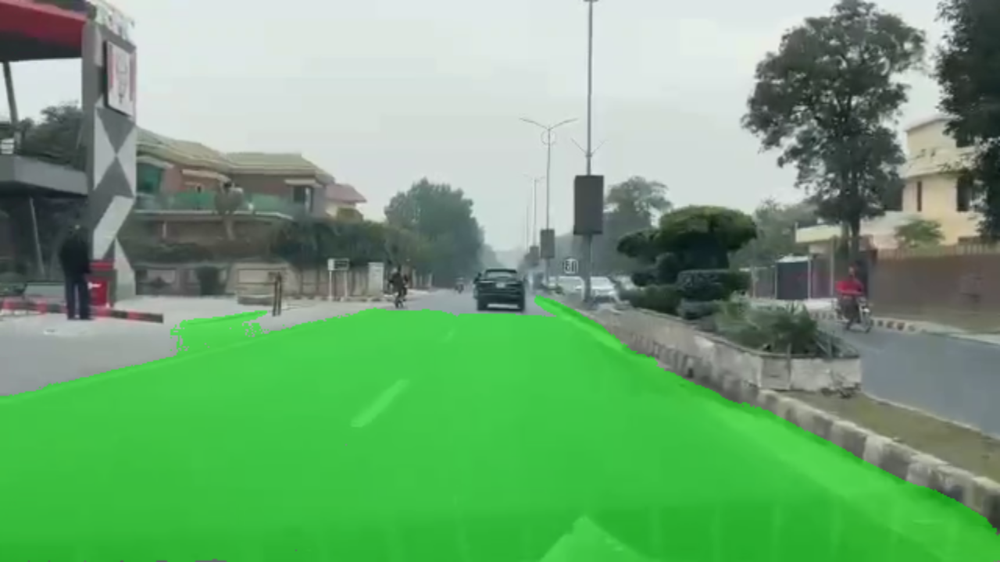

  1%|          | 9/749 [00:28<28:16,  2.29s/it]

image 10/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_106.png: 
(362, 640) (362, 640, 3)


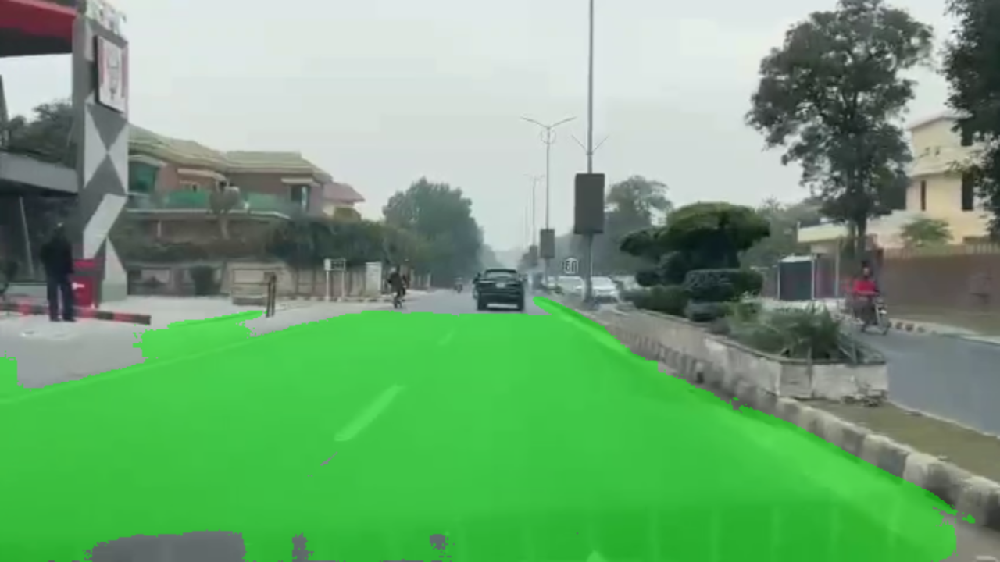

  1%|▏         | 10/749 [00:29<25:57,  2.11s/it]

image 11/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_107.png: 
(362, 640) (362, 640, 3)


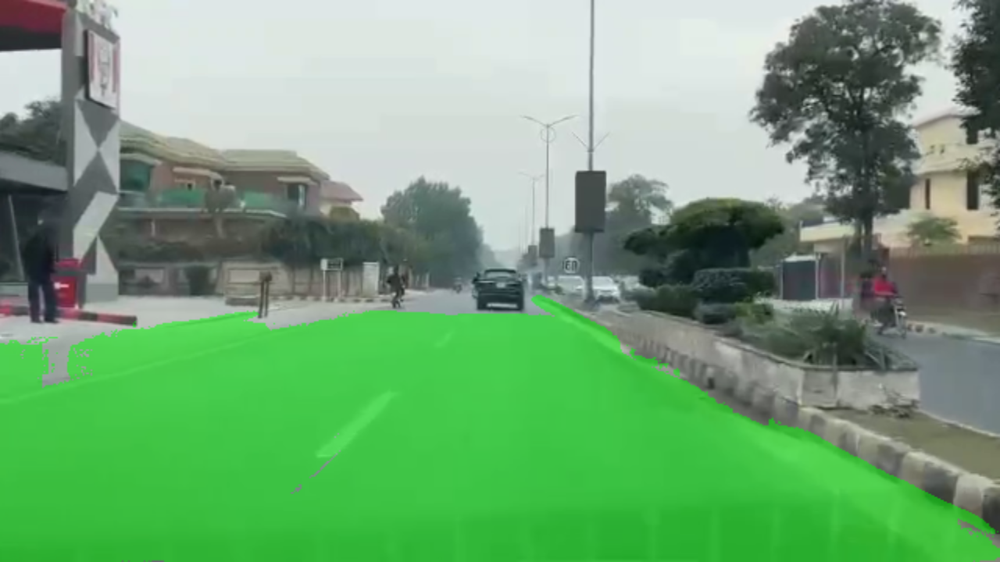

  1%|▏         | 11/749 [00:31<24:13,  1.97s/it]

image 12/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_108.png: 
(362, 640) (362, 640, 3)


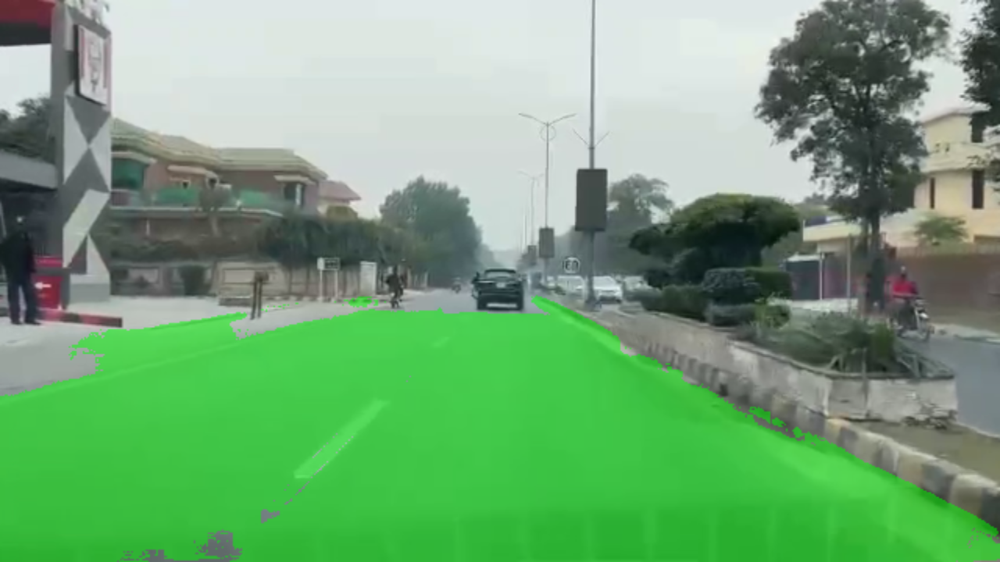

  2%|▏         | 12/749 [00:33<23:08,  1.88s/it]

image 13/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_109.png: 
(362, 640) (362, 640, 3)


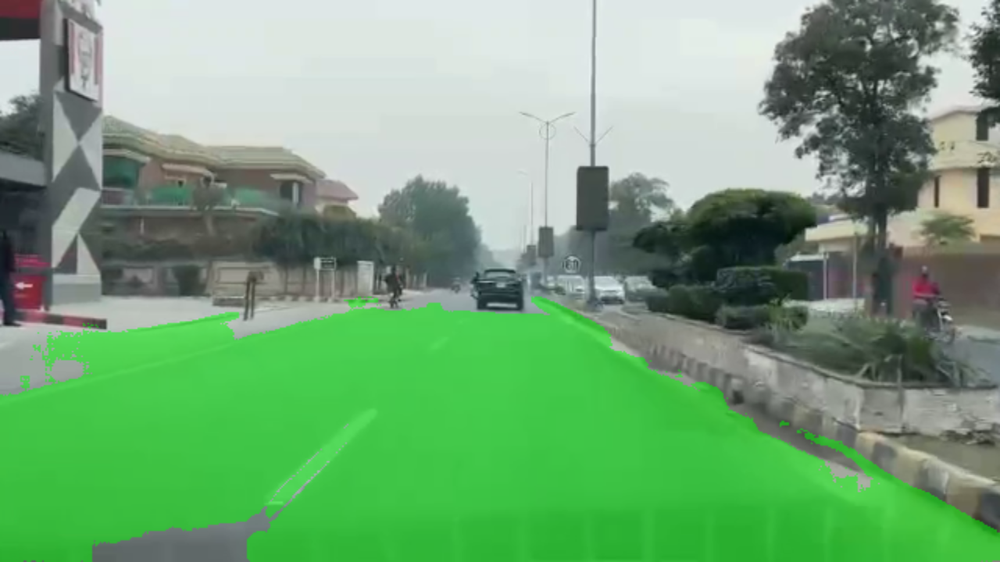

  2%|▏         | 13/749 [00:34<22:12,  1.81s/it]

image 14/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_11.png: 
(362, 640) (362, 640, 3)


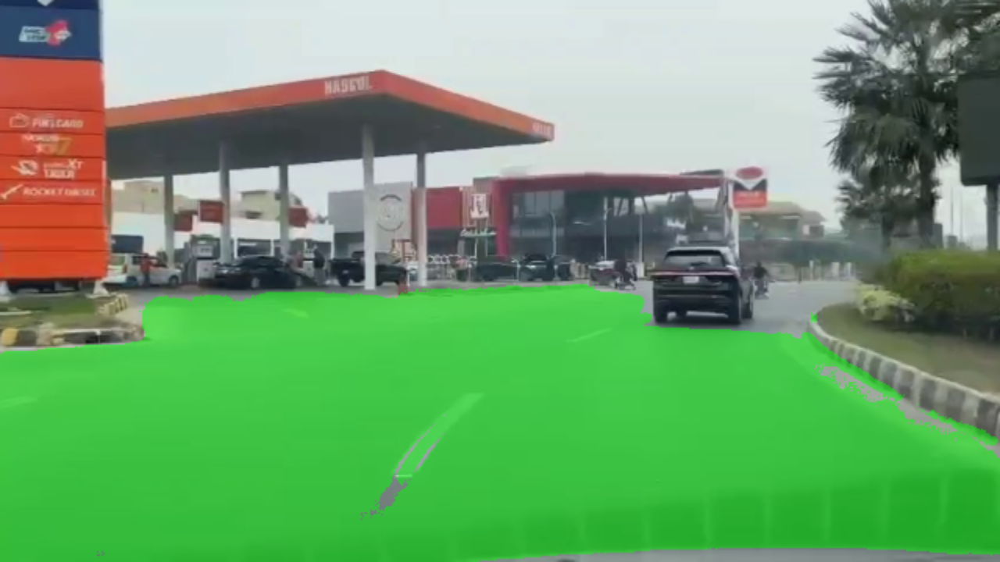

  2%|▏         | 14/749 [00:36<23:09,  1.89s/it]

image 15/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_110.png: 
(362, 640) (362, 640, 3)


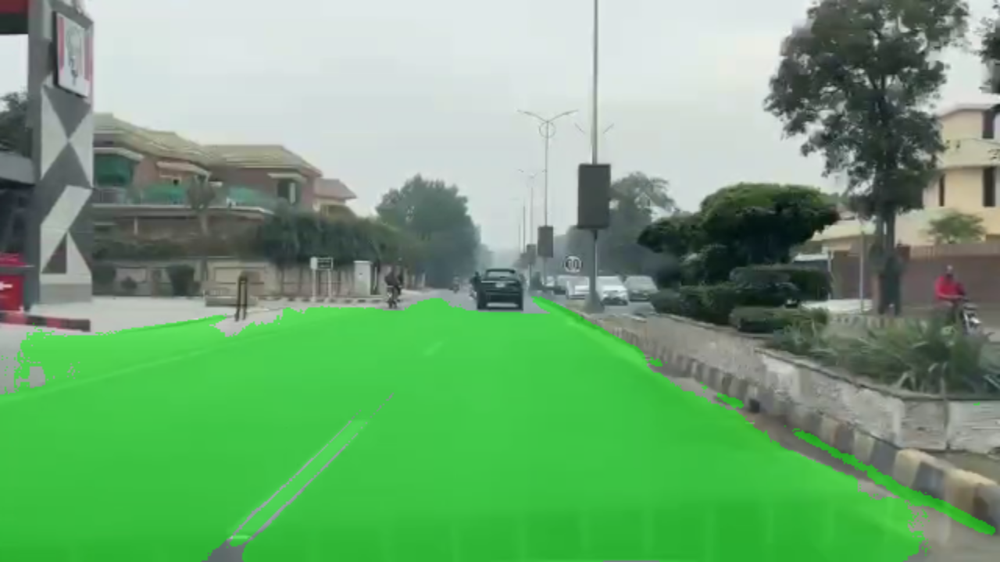

  2%|▏         | 15/749 [00:38<23:28,  1.92s/it]

image 16/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_111.png: 
(362, 640) (362, 640, 3)


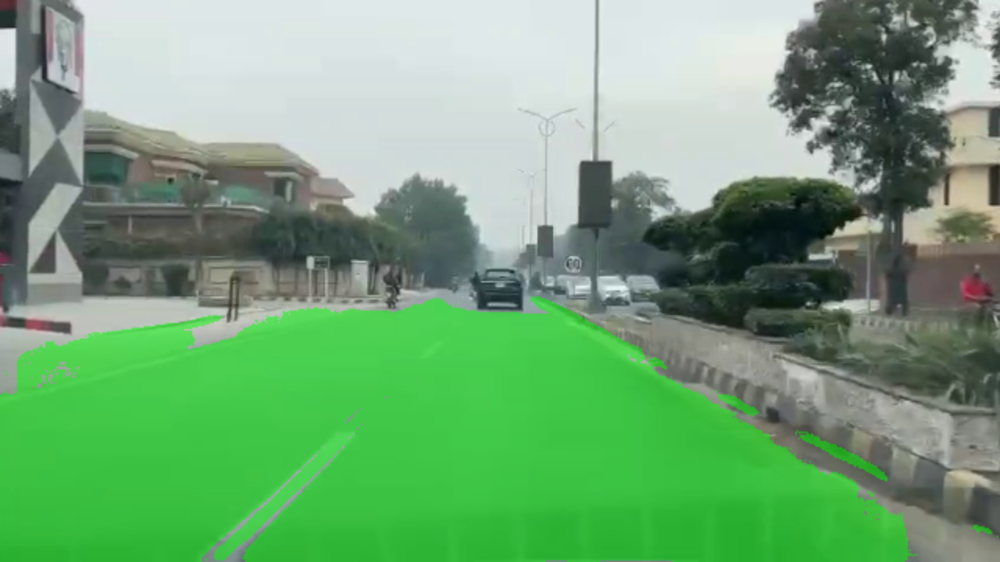

  2%|▏         | 16/749 [00:41<24:13,  1.98s/it]

image 17/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_112.png: 
(362, 640) (362, 640, 3)


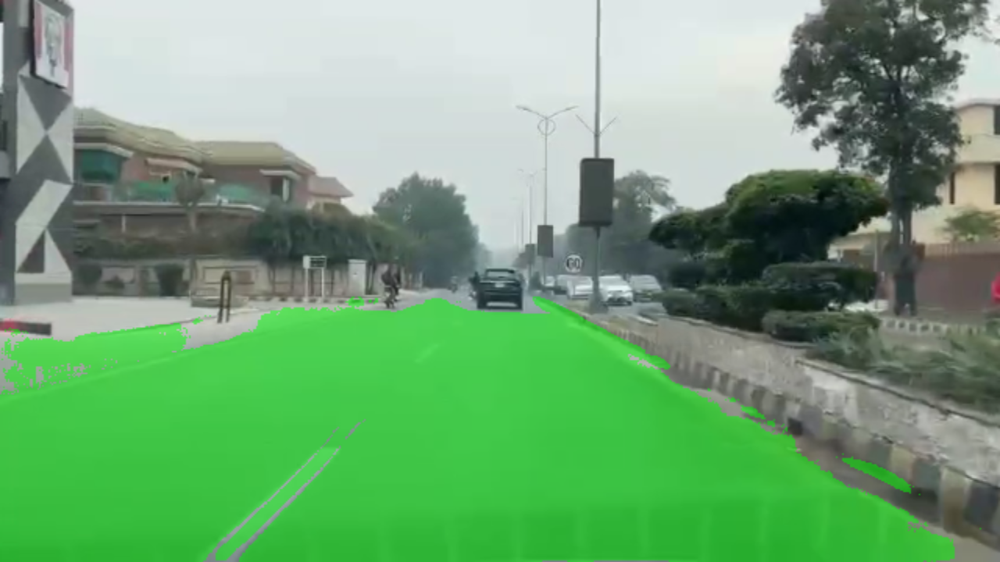

  2%|▏         | 17/749 [00:43<26:20,  2.16s/it]

image 18/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_113.png: 
(362, 640) (362, 640, 3)


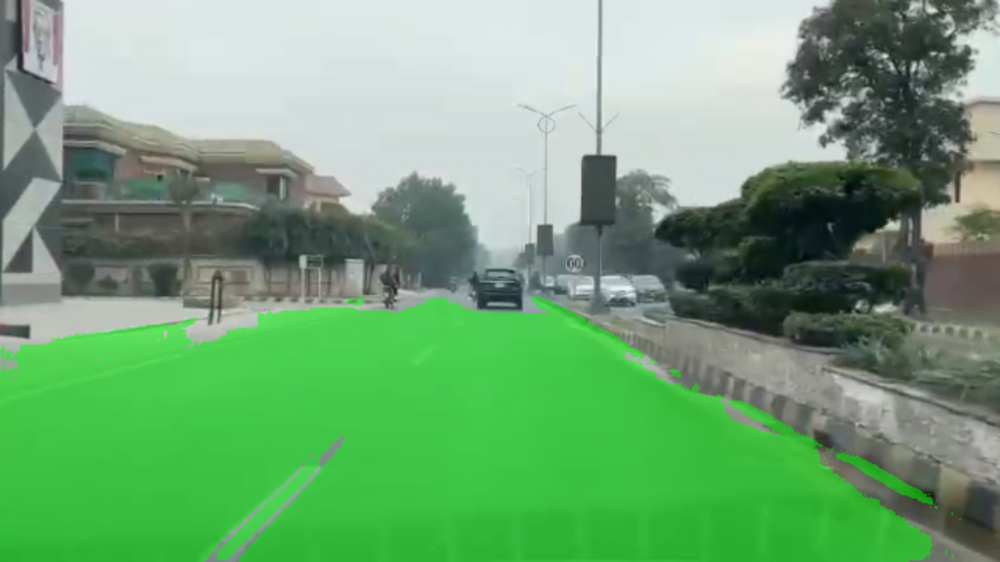

  2%|▏         | 18/749 [00:46<29:31,  2.42s/it]

image 19/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_114.png: 
(362, 640) (362, 640, 3)


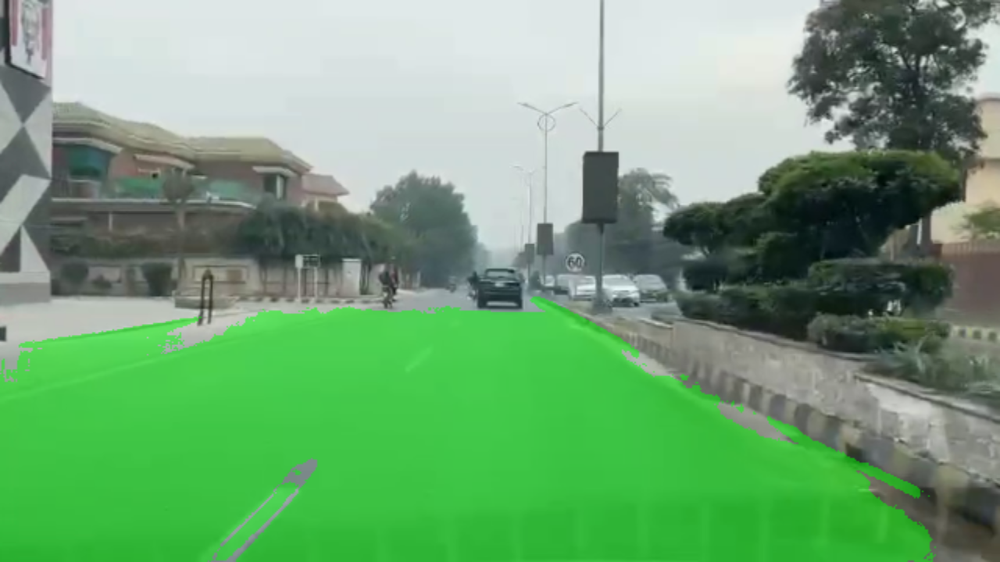

  3%|▎         | 19/749 [00:48<27:07,  2.23s/it]

image 20/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_115.png: 
(362, 640) (362, 640, 3)


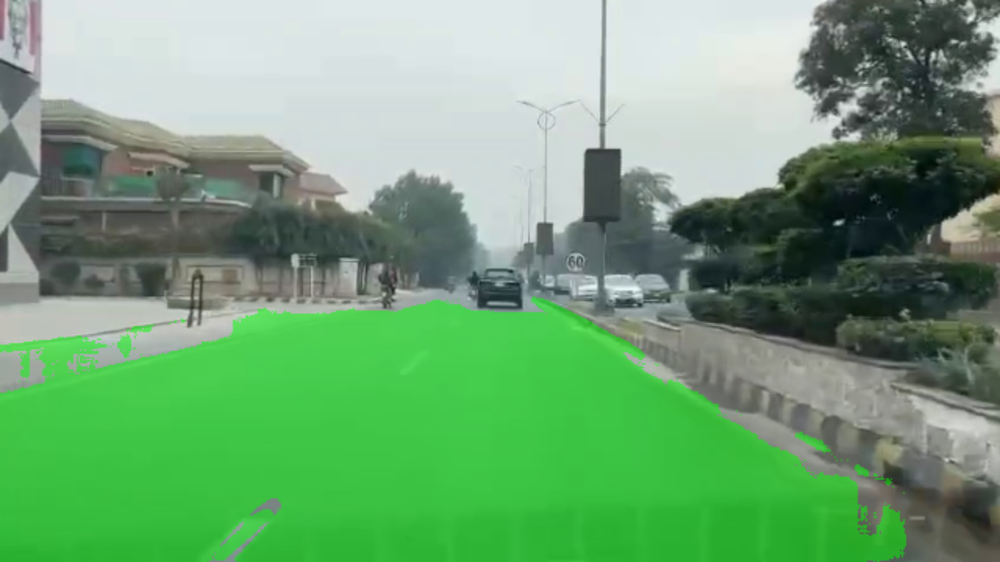

  3%|▎         | 20/749 [00:50<25:20,  2.09s/it]

image 21/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_116.png: 
(362, 640) (362, 640, 3)


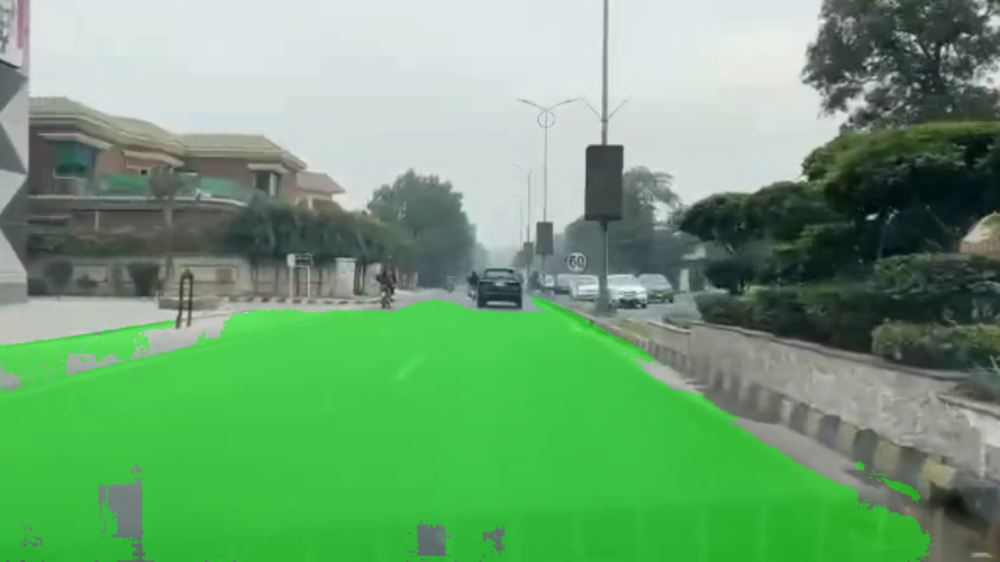

  3%|▎         | 21/749 [00:52<24:09,  1.99s/it]

image 22/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_117.png: 
(362, 640) (362, 640, 3)


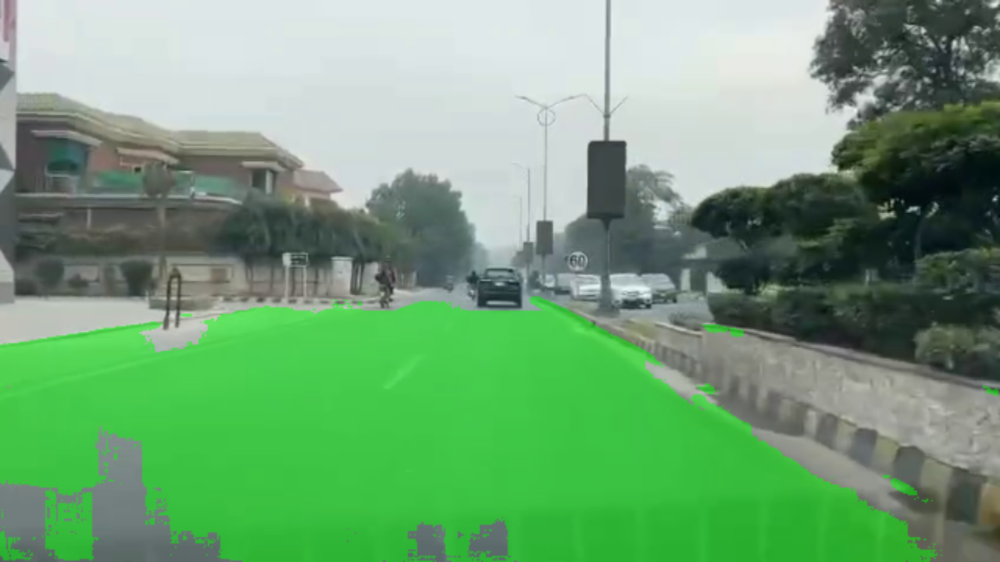

  3%|▎         | 22/749 [00:53<23:22,  1.93s/it]

image 23/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_118.png: 
(362, 640) (362, 640, 3)


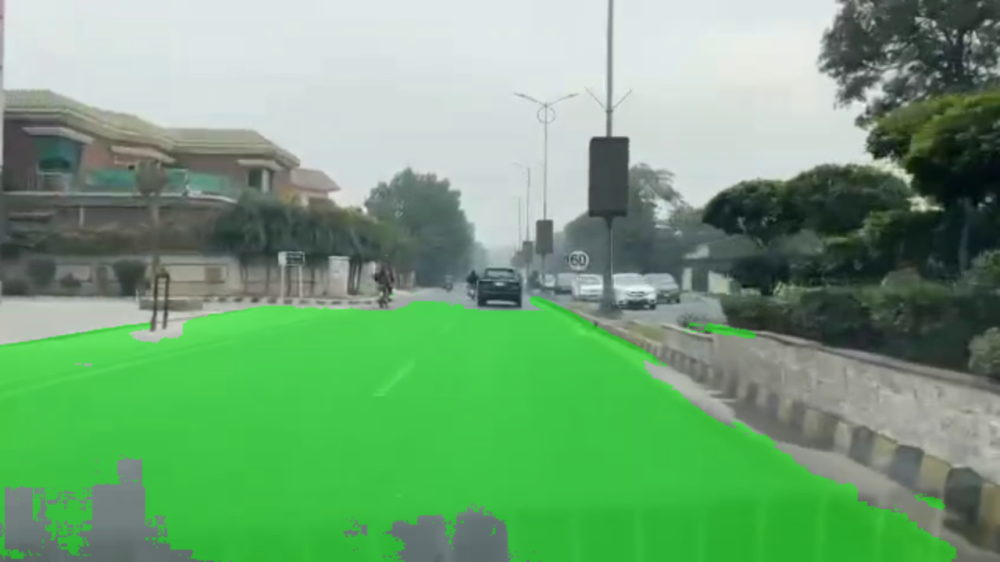

  3%|▎         | 23/749 [00:55<22:16,  1.84s/it]

image 24/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_119.png: 
(362, 640) (362, 640, 3)


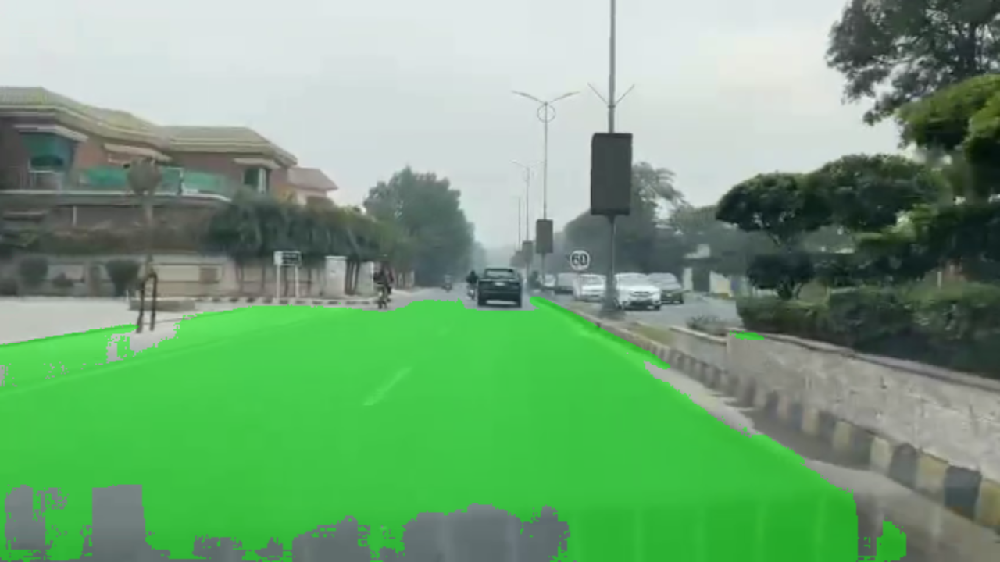

  3%|▎         | 24/749 [00:57<22:18,  1.85s/it]

image 25/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_12.png: 
(362, 640) (362, 640, 3)


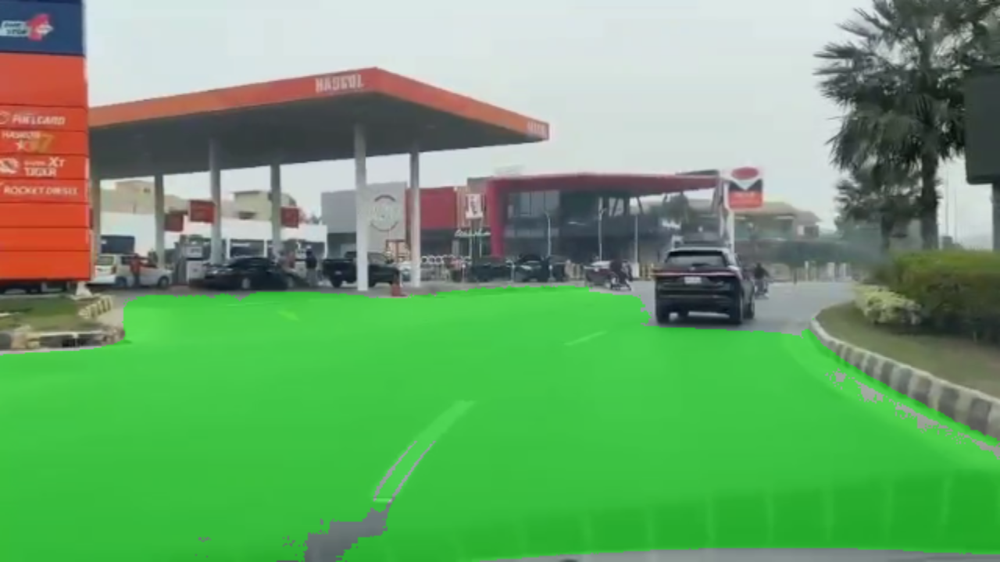

  3%|▎         | 25/749 [00:59<23:35,  1.96s/it]

image 26/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_120.png: 
(362, 640) (362, 640, 3)


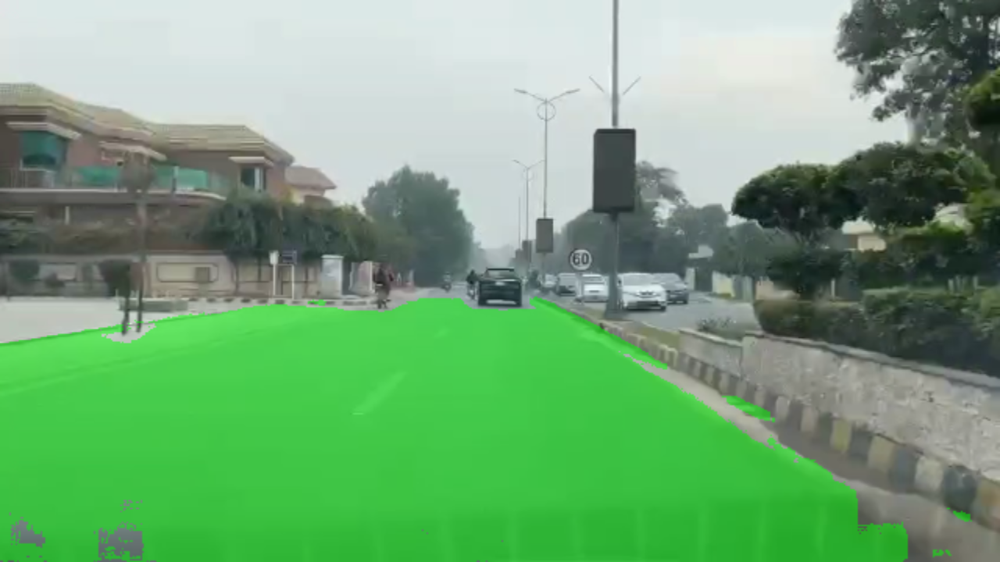

  3%|▎         | 26/749 [01:01<23:07,  1.92s/it]

image 27/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_121.png: 
(362, 640) (362, 640, 3)


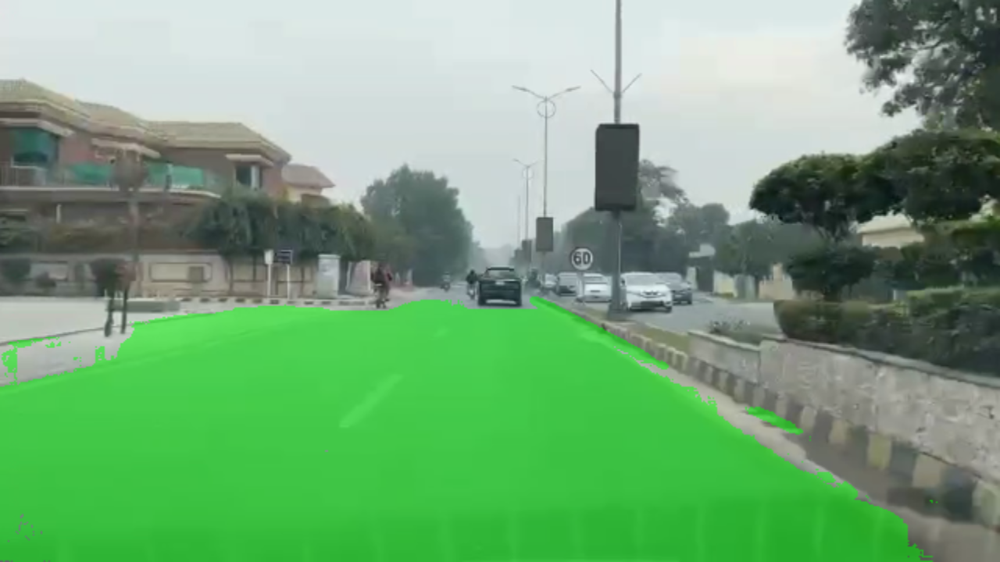

  4%|▎         | 27/749 [01:03<22:53,  1.90s/it]

image 28/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_122.png: 
(362, 640) (362, 640, 3)


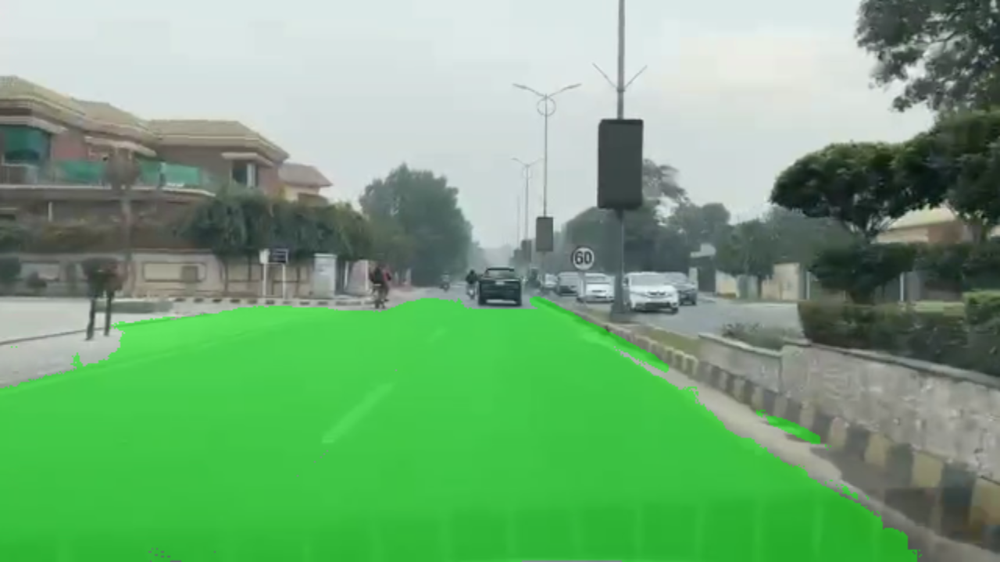

  4%|▎         | 28/749 [01:05<22:33,  1.88s/it]

image 29/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_123.png: 
(362, 640) (362, 640, 3)


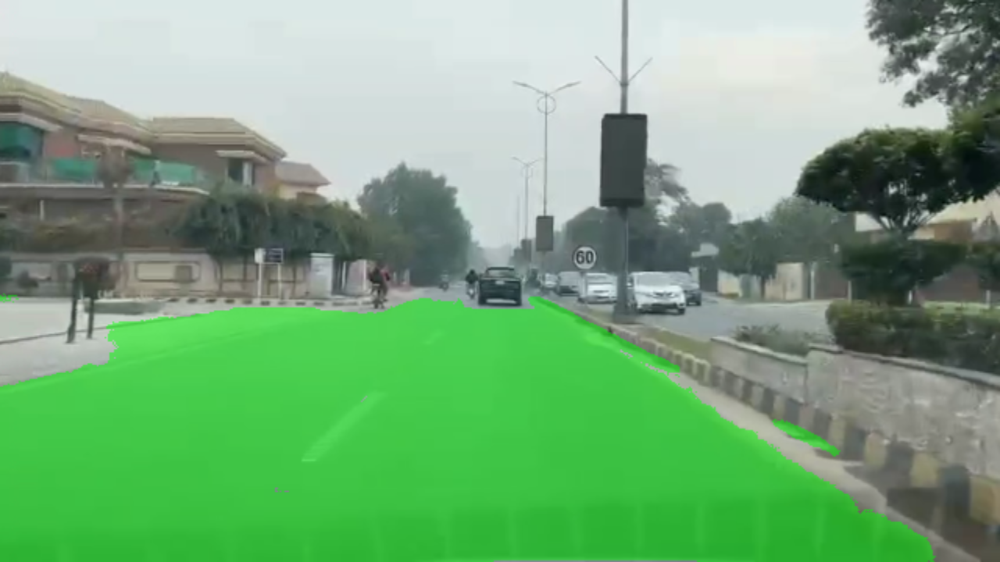

  4%|▍         | 29/749 [01:06<22:10,  1.85s/it]

image 30/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_124.png: 
(362, 640) (362, 640, 3)


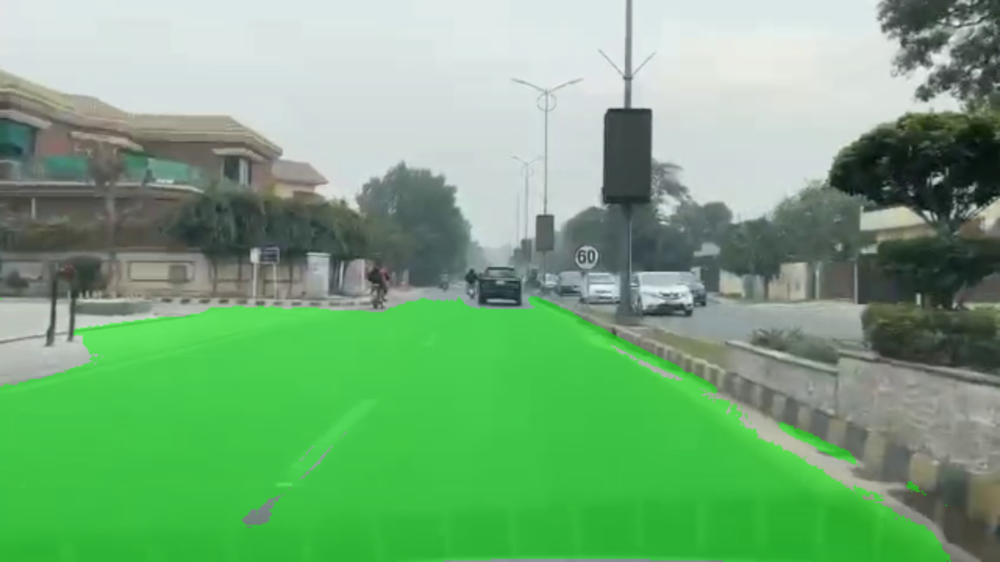

  4%|▍         | 30/749 [01:08<21:50,  1.82s/it]

image 31/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_125.png: 
(362, 640) (362, 640, 3)


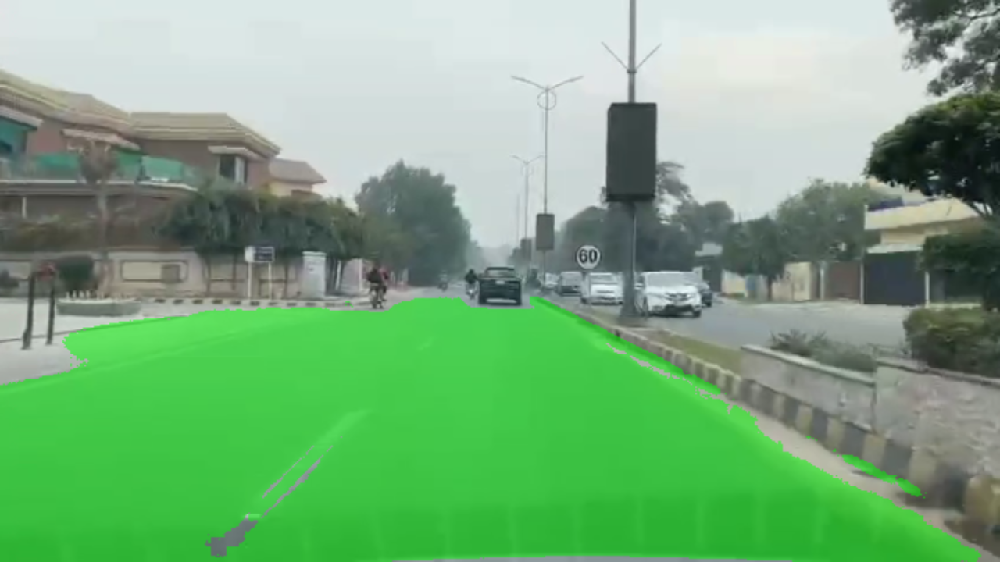

  4%|▍         | 31/749 [01:15<41:00,  3.43s/it]

image 32/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_126.png: 
(362, 640) (362, 640, 3)


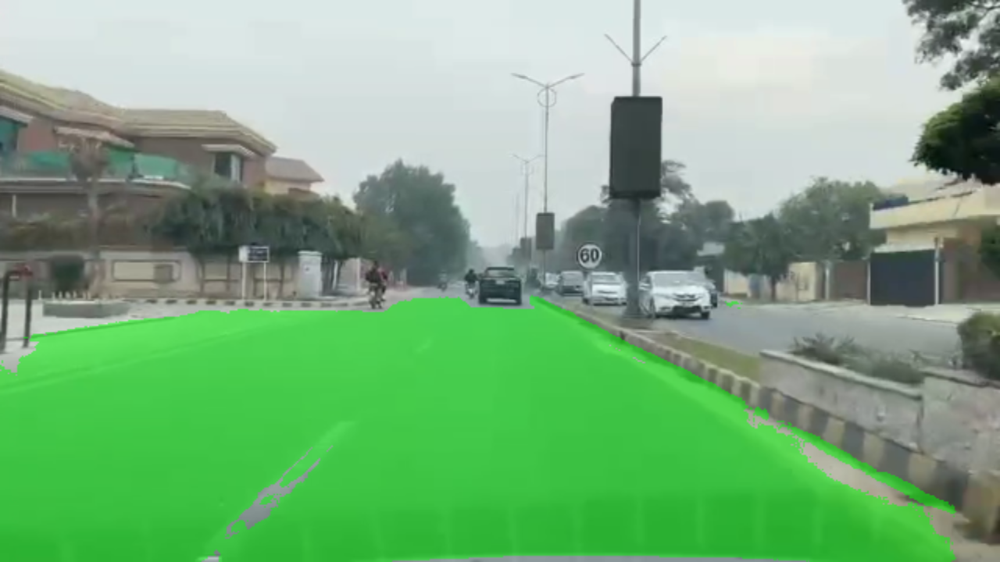

  4%|▍         | 32/749 [01:17<34:41,  2.90s/it]

image 33/749 /content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_127.png: 


In [ ]:
import torch
from torchvision import transforms
from PIL import Image

# from utils import

# model = torch.hub.load('hustvl/YOLOP', 'yolop', pretrained=True)
# img = Image.open('/content/image.png')

# t = transforms.ToTensor()
# resize_transform = transforms.Resize((640, 640))
# tensor_to_img=transforms.ToPILImage()
# features = t(img)
# features = resize_transform(features)
# features = features.unsqueeze(0)
logger, _, _ = create_logger(
    cfg, cfg.LOG_DIR, 'demo')
device = select_device(logger,'cpu')
normalize = transforms.Normalize(
        mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
    )
# device = "cuda:0" if torch.cuda.is_available() else "cpu"
half = device.type != 'cpu'  # half precision only supported on CUDA
transform=transforms.Compose([
            transforms.ToTensor(),
            normalize,
        ])



model = get_net(cfg)
checkpoint = torch.load("weights/End-to-end.pth", map_location= device)
model.load_state_dict(checkpoint['state_dict'])
model = model.to(device)
if half:
    model.half()  # to FP16
source = '/content/drive/My Drive/Colab Notebooks/CV proj/framef'
dataset = LoadImages(source, img_size=640)
names = model.module.names if hasattr(model, 'module') else model.names
colors = [[random.randint(0, 255) for _ in range(3)] for _ in range(len(names))]
img = torch.zeros((1, 3, 640, 640), device=device)  # init img
_ = model(img.half() if half else img) if device.type != 'cpu' else None  # run once
model.eval()

output_directory = '/content/drive/My Drive/Colab Notebooks/CV proj/segment'

for i, (path, img, img_det, vid_cap,shapes) in tqdm(enumerate(dataset),total = len(dataset)):
    img = transform(img).to(device)
    img = img.half() if half else img.float()  # uint8 to fp16/32
    if img.ndimension() == 3:
        img = img.unsqueeze(0)
    det_out, da_seg_out,ll_seg_out= model(img)

# img_det = show_seg_result(img_det, (da_seg_mask, ll_seg_mask), _, _, is_demo=True)



    # print(det_out)
    inf_out,_ = det_out
    det_pred = non_max_suppression(inf_out, conf_thres=0.25, iou_thres=0.45, classes=None, agnostic=False)
    det=det_pred[0]


    _, _, height, width = img.shape
    h,w,_=img_det.shape
    # print(h,w)
    pad_w, pad_h = shapes[1][1]
    # print(shapes)
    pad_w = int(pad_w)
    pad_h = int(pad_h)
    ratio = shapes[1][0][1]

    da_predict = da_seg_out[:, :, pad_h:(height-pad_h),pad_w:(width-pad_w)]
    da_seg_mask = torch.nn.functional.interpolate(da_predict, scale_factor=int(1/ratio), mode='bilinear')
    _, da_seg_mask = torch.max(da_seg_mask, 1)
    da_seg_mask = da_seg_mask.int().squeeze().cpu().numpy()



    ll_predict = ll_seg_out[:, :,pad_h:(height-pad_h),pad_w:(width-pad_w)]
    ll_seg_mask = torch.nn.functional.interpolate(ll_predict, scale_factor=int(1/ratio), mode='bilinear')
    _, ll_seg_mask = torch.max(ll_seg_mask, 1)

    ll_seg_mask = ll_seg_mask.int().squeeze().cpu().numpy()
    # print(ll_seg_mask.shape)



    # img_det = show_seg_result(img_det, (da_seg_mask, ll_seg_mask), _, _, is_demo=True)

    # cv2_imshow( img_det)

    palette = np.random.randint(
            0, 255, size=(2, 2))
    palette[0] = [0, 0]
    palette[1] = [0, 255]
    # palette[2] = [255, 0, 0]
    palette = np.array(palette)
    assert palette.shape[0] == 2 # len(classes)
    assert palette.shape[1] == 2
    assert len(palette.shape) == 2

    result = (da_seg_mask, ll_seg_mask)
    color_area = np.zeros((result[0].shape[0], result[0].shape[1], 3), dtype=np.uint8)
    color_area[result[0] == 1] = [0, 255, 0]
    color_area[result[1] ==1] = [0, 255, 0]

    color_seg = color_area
    color_seg = color_seg[..., ::-1]
    color_mask = np.mean(color_seg, 2)
    # print(color_mask.shape)
    img_r=img_det

    # print(color_mask[1],color_mask[0])

    img_r = cv2.resize(img_r, (color_mask.shape[1],color_mask.shape[0]), interpolation=cv2.INTER_LINEAR)

    # print(type(color_mask[0][0]),type(img_r[0][0][0]))
    print(color_mask.shape,img_r.shape)
    img_r[color_mask != 0] = img_r[color_mask != 0] * 0.5 + color_seg[color_mask != 0] * 0.5
    img_r = img_r.astype(np.uint8)
    img_r = cv2.resize(img_r, (1280,720), interpolation=cv2.INTER_LINEAR)
    cv2_imshow(img_r)

    # green_mask = np.zeros_like(img_r)
    # green_mask[(img_r[:, :, 1] == 255) & (img_r[:, :, 0] == 0) & (img_r[:, :, 2] == 0)] = [0, 255, 0]

    # green_mask_resized = cv2.resize(green_mask, (img_det.shape[1], img_det.shape[0]), interpolation=cv2.INTER_NEAREST)

    # # Ensure the dimensions match by slicing the mask if needed
    # green_mask_resized = green_mask_resized[:img_det.shape[0], :img_det.shape[1], :]

    # # Blend the original image with the green mask
    # result = cv2.addWeighted(img_det, 1, green_mask_resized, 0.5, 0)

    # # Display the result
    # cv2_imshow(result)

    # # Save the result to the output directory
    # output_path = os.path.join(output_directory, f"segmented_frame_{i}.png")
    # cv2.imwrite(output_path, result)

# cv2_imshow(det_out)

In [4]:
import matplotlib
from matplotlib import interactive
interactive(True)
# !pip install opencv-python
# import matplotlib.pyplot as ajeeb
import cv2
import math
from matplotlib import pyplot as plt
from matplotlib import cm
from matplotlib import image as mpimg
from matplotlib.pyplot import figure
import seaborn as sns
import numpy as np
%matplotlib inline
from scipy import linalg
from scipy.linalg import null_space
# !pip install imageio
import imageio

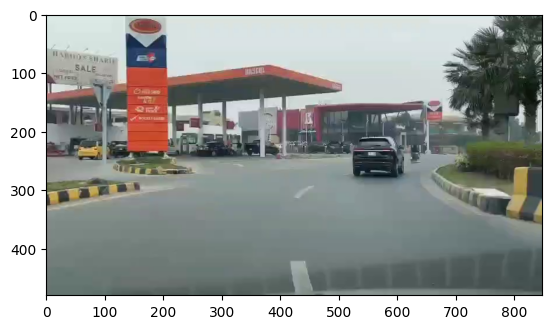

<Figure size 1000x1000 with 0 Axes>

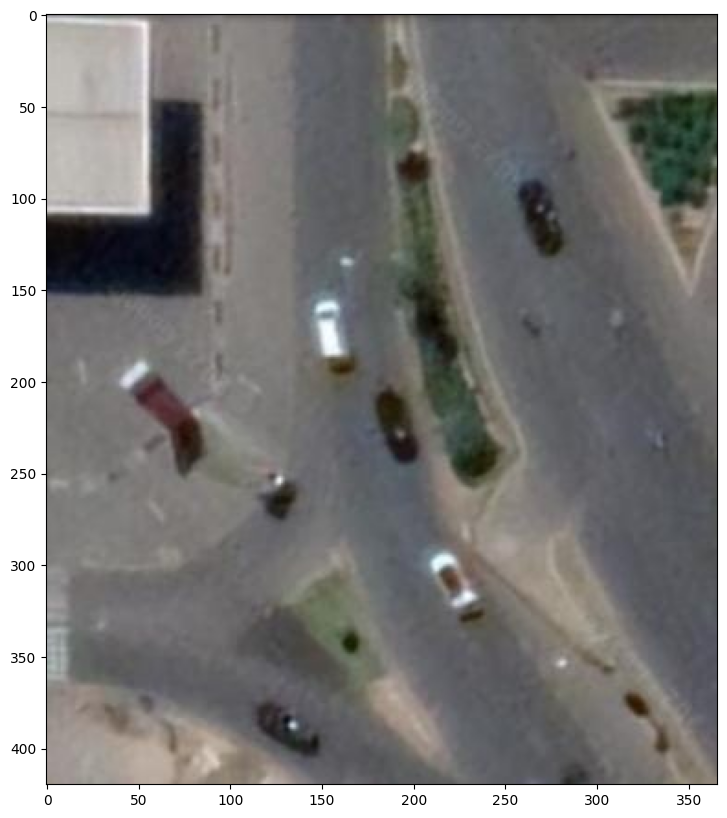

In [5]:
plt.figure(figsize=(10, 10))
img1 = plt.imread('/content/drive/My Drive/Colab Notebooks/CV proj/framef/frame_0.png')
figure(2)
plt.imshow(img1)


plt.figure(figsize=(10, 10))
img2 = plt.imread('/content/drive/My Drive/Colab Notebooks/CV proj/top1.jpg')
figure(1)
plt.imshow(img2)

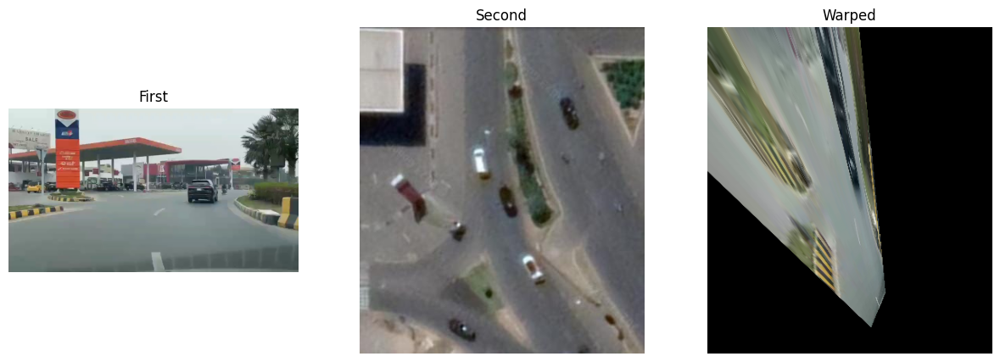

In [6]:
import cv2
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

# Your homography points
pts_src = np.array([[161, 303], [745, 335], [384, 257], [681, 253]])
pts_dst = np.array([[162, 291], [218, 281], [136, 117], [188, 115]])

# Calculate Homography
h, status = cv2.findHomography(pts_src, pts_dst)

# Assume img1 is already loaded
# Apply warp perspective
im_out = cv2.warpPerspective(img1, h, (img2.shape[1], img2.shape[0]))

# Display the images using matplotlib
fig = plt.figure(figsize=(15, 5))

# Original image (img1)
fig.add_subplot(1, 3, 1)
plt.imshow(img1)
plt.axis('off')
plt.title("First")

# Original image (img2)
fig.add_subplot(1, 3, 2)
plt.imshow(img2)
plt.axis('off')
plt.title("Second")

# Warped image (im_out)
fig.add_subplot(1, 3, 3)
plt.imshow(im_out)
plt.axis('off')
plt.title("Warped")

plt.show()


In [ ]:
import cv2
import os
from matplotlib import pyplot as plt

# Path to the segmented images folder
segmented_folder = "drive/My Drive/Colab Notebooks/CV proj/framef"

# Path to the top view images folder
top_views_folder = "drive/My Drive/Colab Notebooks/CV proj/topviews"

# Path to the reference image (img2)
img2_path = "drive/My Drive/Colab Notebooks/CV proj/top1.jpg"
img2 = cv2.imread(img2_path)

# Assuming you already have the homography matrix 'h' obtained from cv2.findHomography
# ...

# Create the output folder if it doesn't exist
os.makedirs(top_views_folder, exist_ok=True)

# Loop through segmented images
for i in range(1, 749):  # Assuming segmented_frame_0.png is already processed
    segmented_img_path = os.path.join(segmented_folder, f"frame_{i}.png")

    # Read the segmented image
    img1 = cv2.imread(segmented_img_path)

    # Apply warp perspective
    im_out = cv2.warpPerspective(img1, h, (img2.shape[1], img2.shape[0]))

    # Save the result in the top views folder
    output_path = os.path.join(top_views_folder, f"top_view_frame_{i}.png")
    cv2.imwrite(output_path, im_out)

In [8]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
%config IPCompleter.greedy=True
%config Completer.use_jedi = False

In [ ]:
import os

# Specify the name of the images (without the index)
img_name = 'top_view_frame'

# Specify the path to the folder containing the images
images_folder = 'drive/My Drive/Colab Notebooks/CV proj/topviews'

# Get a list of image filenames in the folder
image_files = sorted([f for f in os.listdir(images_folder) if f.startswith(img_name) and f.endswith('.png')])

# Calculate the number of images
num_images = len(image_files)

# Order of the images for stitching (assuming left-to-right order)
order = range(num_images, 1, -1)

# Specify the output file path
output_file_path = 'drive/My Drive/Colab Notebooks/CV proj/adobe_panorama.txt'

# Generate the necessary txt file for the Super Glue algorithm
with open(output_file_path, 'w') as file:
    for i in order:
        file.write("{}_{:d}.png {}_{:d}.png\n".format(img_name, i, img_name, i - 1))


In [ ]:
!git clone https://github.com/magicleap/SuperGluePretrainedNetwork.git

Cloning into 'SuperGluePretrainedNetwork'...
remote: Enumerating objects: 182, done.
remote: Total 182 (delta 0), reused 0 (delta 0), pack-reused 182
Receiving objects: 100% (182/182), 118.85 MiB | 27.21 MiB/s, done.
Resolving deltas: 100% (52/52), done.


In [ ]:
!python /content/SuperGluePretrainedNetwork/match_pairs.py  --resize -1 --superglue outdoor --input_dir '/content/drive/MyDrive/Colab Notebooks/CV proj/topviews' --input_pairs '/content/drive/MyDrive/Colab Notebooks/CV proj/adobe_panorama.txt' --output_dir '/content/drive/MyDrive/Colab Notebooks/CV proj/output'

Namespace(input_pairs='/content/drive/MyDrive/Colab Notebooks/CV proj/adobe_panorama.txt', input_dir='/content/drive/MyDrive/Colab Notebooks/CV proj/topviews', output_dir='/content/drive/MyDrive/Colab Notebooks/CV proj/output', max_length=-1, resize=[-1], resize_float=False, superglue='outdoor', max_keypoints=1024, keypoint_threshold=0.005, nms_radius=4, sinkhorn_iterations=20, match_threshold=0.2, viz=False, eval=False, fast_viz=False, cache=False, show_keypoints=False, viz_extension='png', opencv_display=False, shuffle=False, force_cpu=False)
Will not resize images
Running inference on device "cpu"
Loaded SuperPoint model
Loaded SuperGlue model ("outdoor" weights)
Looking for data in directory "/content/drive/MyDrive/Colab Notebooks/CV proj/topviews"
Will write matches to directory "/content/drive/MyDrive/Colab Notebooks/CV proj/output"
[Finished pair     0 of   747] load_image=0.016 matcher=1.785 total=1.801 sec {0.6 FPS} 
[Finished pair     1 of   747] load_image=0.015 matcher=1.77

In [ ]:
import os
import numpy as np

# Specify the name of the images (without the index)
img_name = 'top_view_frame'

# Calculate the number of images
num_images = 748

# Order of the images for stitching (assuming left-to-right order)
order = range(num_images, 1, -1)

# List of NPZ files to read
npz_files = ["{img}_{:d}_{img}_{:d}_matches.npz".format(i, i - 1, img=img_name) for i in order]

# Specify the path to the output directory
output_dir = '/content/drive/MyDrive/Colab Notebooks/CV proj/output'

# Loop through the NPZ files
for file in npz_files:
    path = os.path.join(output_dir, file)
    try:
        npz = np.load(path)
        print(npz.files)
        # Access and use the data from the NPZ file as needed
        # For example, print keypoints and matches
        keypoints0 = npz['keypoints0']
        keypoints1 = npz['keypoints1']
        matches = npz['matches']
        print("Keypoints 0 shape:", keypoints0.shape)
        print("Keypoints 1 shape:", keypoints1.shape)
        print("Matches shape:", matches.shape)
    except FileNotFoundError:
        print(f"File not found: {path}")


['keypoints0', 'keypoints1', 'matches', 'match_confidence']
Keypoints 0 shape: (90, 2)
Keypoints 1 shape: (100, 2)
Matches shape: (90,)
['keypoints0', 'keypoints1', 'matches', 'match_confidence']
Keypoints 0 shape: (100, 2)
Keypoints 1 shape: (95, 2)
Matches shape: (100,)
['keypoints0', 'keypoints1', 'matches', 'match_confidence']
Keypoints 0 shape: (95, 2)
Keypoints 1 shape: (102, 2)
Matches shape: (95,)
['keypoints0', 'keypoints1', 'matches', 'match_confidence']
Keypoints 0 shape: (102, 2)
Keypoints 1 shape: (89, 2)
Matches shape: (102,)
['keypoints0', 'keypoints1', 'matches', 'match_confidence']
Keypoints 0 shape: (89, 2)
Keypoints 1 shape: (102, 2)
Matches shape: (89,)
['keypoints0', 'keypoints1', 'matches', 'match_confidence']
Keypoints 0 shape: (102, 2)
Keypoints 1 shape: (94, 2)
Matches shape: (102,)
['keypoints0', 'keypoints1', 'matches', 'match_confidence']
Keypoints 0 shape: (94, 2)
Keypoints 1 shape: (107, 2)
Matches shape: (94,)
['keypoints0', 'keypoints1', 'matches', 'matc

In [ ]:
import os
import numpy as np

def loadNPZ(output_dir, img_name, idx1, idx2):
    # Construct the filename based on the indices
    npz_file = "{}_{:d}_{}_{:d}_matches.npz".format(img_name, idx1, img_name, idx2)
    path = os.path.join(output_dir, npz_file)

    try:
        npz = np.load(path)
        point_set1 = npz['keypoints0'][npz['matches'] > -1]
        matching_indexes = npz['matches'][npz['matches'] > -1]  # -1 if the keypoint is unmatched
        point_set2 = npz['keypoints1'][matching_indexes]
        print("Number of matching points for the findHomography algorithm:")
        print("In left  image:", len(point_set1), "\nIn right image:", len(point_set2))
        return point_set1, point_set2
    except FileNotFoundError:
        print(f"File not found: {path}")
        return None, None

# Example usage
output_dir = '/content/drive/MyDrive/Colab Notebooks/CV proj/output'
img_name = 'top_view_frame'
idx1 = 10
idx2 = 9

point_set1, point_set2 = loadNPZ(output_dir, img_name, idx1, idx2)

# Print the point sets
print("Point Set 1:")
print(point_set1)

print("\nPoint Set 2:")
print(point_set2)


Number of matching points for the findHomography algorithm:
In left  image: 65 
In right image: 65
Point Set 1:
[[156.  29.]
 [135.  36.]
 [198.  40.]
 [199.  45.]
 [199.  56.]
 [108.  65.]
 [121.  80.]
 [125.  85.]
 [166.  98.]
 [ 84. 102.]
 [129. 105.]
 [ 76. 119.]
 [112. 148.]
 [ 60. 166.]
 [ 21. 171.]
 [183. 172.]
 [212. 176.]
 [132. 184.]
 [157. 185.]
 [213. 186.]
 [135. 189.]
 [ 55. 190.]
 [213. 195.]
 [214. 207.]
 [ 71. 215.]
 [215. 216.]
 [ 69. 227.]
 [ 98. 229.]
 [ 62. 232.]
 [118. 232.]
 [ 87. 234.]
 [105. 235.]
 [110. 235.]
 [189. 236.]
 [ 78. 242.]
 [112. 243.]
 [102. 246.]
 [219. 246.]
 [ 87. 249.]
 [132. 251.]
 [103. 253.]
 [109. 253.]
 [121. 254.]
 [220. 255.]
 [140. 263.]
 [114. 267.]
 [120. 267.]
 [135. 277.]
 [221. 278.]
 [126. 285.]
 [119. 289.]
 [133. 289.]
 [126. 295.]
 [200. 300.]
 [122. 301.]
 [224. 307.]
 [226. 316.]
 [226. 325.]
 [151. 330.]
 [175. 337.]
 [228. 340.]
 [210. 341.]
 [172. 350.]
 [220. 360.]
 [209. 385.]]

Point Set 2:
[[155.  22.]
 [131.  28.]
 [

In [ ]:
pip install opencv-python

In [ ]:
pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 654.0/654.0 kB 4.7 MB/s eta 0:00:00


In [ ]:
!git clone https://github.com/ultralytics/ultralytics
%cd ultralytics
!pip install -e .

Cloning into 'ultralytics'...
remote: Enumerating objects: 20448, done.
remote: Counting objects: 100% (1635/1635), done.
remote: Compressing objects: 100% (891/891), done.
remote: Total 20448 (delta 980), reused 1227 (delta 740), pack-reused 18813
Receiving objects: 100% (20448/20448), 11.41 MiB | 6.87 MiB/s, done.
Resolving deltas: 100% (14166/14166), done.
/content/ultralytics
Obtaining file:///content/ultralytics
  Preparing metadata (setup.py) ... done
  Attempting uninstall: ultralytics
    Found existing installation: ultralytics 8.0.222
    Uninstalling ultralytics-8.0.222:
      Successfully uninstalled ultralytics-8.0.222
  Running setup.py develop for ultralytics


In [ ]:
!pip uninstall imageai

Found existing installation: imageai 3.0.3
Uninstalling imageai-3.0.3:
  Would remove:
    /usr/local/lib/python3.10/dist-packages/imageai-3.0.3.dist-info/*
    /usr/local/lib/python3.10/dist-packages/imageai/*
Proceed (Y/n)? Y
  Successfully uninstalled imageai-3.0.3


In [ ]:
!apt-get install -y libblas-dev liblapack-dev libatlas-base-dev gfortran
!pip install numpy==1.19.3
!pip install scipy==1.4.1
!pip install numpy==1.19.3
!pip install scipy==1.4.1
!pip install --upgrade setuptools

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
gfortran is already the newest version (4:11.2.0-1ubuntu1).
liblapack-dev is already the newest version (3.10.0-2ubuntu1).
libatlas-base-dev is already the newest version (3.10.3-12ubuntu1).
Suggested packages:
  liblapack-doc
The following NEW packages will be installed:
  libblas-dev
0 upgraded, 1 newly installed, 0 to remove and 15 not upgraded.
Need to get 164 kB of archives.
After this operation, 1,084 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libblas-dev amd64 3.10.0-2ubuntu1 [164 kB]
Fetched 164 kB in 0s (563 kB/s)
Selecting previously unselected package libblas-dev:amd64.
(Reading database ... 120882 files and directories currently installed.)
Preparing to unpack .../libblas-dev_3.10.0-2ubuntu1_amd64.deb ...
Unpacking libblas-dev:amd64 (3.10.0-2ubuntu1) ...
Setting up libblas-dev:amd64 (3.10.0-2ubuntu1) ...
  Using cached numpy

/usr/local/lib/python3.10/dist-packages/google/colab/_pip.py:85: ResourceWarning: unclosed file <_io.TextIOWrapper name='/usr/local/lib/python3.10/dist-packages/setuptools-69.0.2.dist-info/top_level.txt' mode='r' encoding='UTF-8'>
  for line in open(toplevel):


In [ ]:
!pip install imageai==2.1.6
! pip install opencv-python
! pip install Pillow

In [ ]:
from imageai.Detection import VideoObjectDetection

In [ ]:
vid_obj_detect = VideoObjectDetection()

In [ ]:
vid_obj_detect.setModelTypeAsYOLOv3()

In [ ]:
pip install cython pillow>=7.0.0 numpy>=1.18.1 opencv-python>=4.1.2 torch>=1.9.0 --extra-index-url https://download.pytorch.org/whl/cpu torchvision>=0.10.0 --extra-index-url https://download.pytorch.org/whl/cpu pytest==7.1.3 tqdm==4.64.1 scipy>=1.7.3 matplotlib>=3.4.3 mock==4.0.3


In [ ]:
pip install cython pillow>=7.0.0 numpy>=1.18.1 opencv-python>=4.1.2 torch>=1.9.0 --extra-index-url https://download.pytorch.org/whl/cu102 torchvision>=0.10.0 --extra-index-url https://download.pytorch.org/whl/cu102 pytest==7.1.3 tqdm==4.64.1 scipy>=1.7.3 matplotlib>=3.4.3 mock==4.0.3


In [ ]:
pip install pycocotools@git+https://github.com/gautamchitnis/cocoapi.git@cocodataset-master#subdirectory=PythonAPI


  Cloning https://github.com/gautamchitnis/cocoapi.git (to revision cocodataset-master) to /tmp/pip-install-oqpaca5m/pycocotools_843b1f88f226452bbd22f102406a82ea
  Running command git clone --filter=blob:none --quiet https://github.com/gautamchitnis/cocoapi.git /tmp/pip-install-oqpaca5m/pycocotools_843b1f88f226452bbd22f102406a82ea
  Running command git checkout -b cocodataset-master --track origin/cocodataset-master
  Switched to a new branch 'cocodataset-master'
  Branch 'cocodataset-master' set up to track remote branch 'cocodataset-master' from 'origin'.
  Resolved https://github.com/gautamchitnis/cocoapi.git to commit 20291f19c46a8d11935862bc9e449a1b72ec25ed
  Preparing metadata (setup.py) ... done
  Created wheel for pycocotools: filename=pycocotools-2.0-cp310-cp310-linux_x86_64.whl size=375585 sha256=4a3778b7a5cbb1e142a6234bb32170af102e503309511f5dde50e620deb885a7
  Stored in directory: /tmp/pip-ephem-wheel-cache-arzy13a5/wheels/83/c2/a9/31695b4858fd20696ebf8ae959a4e447159f8bf667

/usr/local/lib/python3.10/dist-packages/google/colab/_pip.py:85: ResourceWarning: unclosed file <_io.TextIOWrapper name='/usr/local/lib/python3.10/dist-packages/pycocotools-2.0.dist-info/top_level.txt' mode='r' encoding='UTF-8'>
  for line in open(toplevel):


In [ ]:
pip install imageai --upgrade


In [ ]:
!pip install imageAI==2.1.6

In [ ]:
vid_obj_detect.setModelPath(r"drive/MyDrive/Colab Notebooks/CV proj/yolo.h5")
vid_obj_detect.loadModel()

In [ ]:
detected_vid_obj = vid_obj_detect.detectObjectsFromVideo(
    input_file_path =  r"/content/drive/MyDrive/Colab Notebooks/CV proj/Video 1.mp4",
    output_file_path = r"/content/drive/MyDrive/Colab Notebooks/CV proj",
    frames_per_second=15,
    log_progress=True,
    return_detected_frame = True
)

Panorama saved to /content/drive/My Drive/Colab Notebooks/CV proj/panorama/pano.jpg


In [ ]:
import os
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

def loadNPZ(output_dir, img_name, idx1, idx2):
    # Construct the filename based on the indices
    npz_file = "{}_{:d}_{}_{:d}_matches.npz".format(img_name, idx1, img_name, idx2)
    path = os.path.join(output_dir, npz_file)

    try:
        npz = np.load(path)
        point_set1 = npz['keypoints0'][npz['matches'] > -1]
        matching_indexes = npz['matches'][npz['matches'] > -1]  # -1 if the keypoint is unmatched
        point_set2 = npz['keypoints1'][matching_indexes]
        # print("Number of matching points for the findHomography algorithm:")
        # print("In left  image:", len(point_set1), "\nIn right image:", len(point_set2))
        return point_set1, point_set2
    except FileNotFoundError:
        print(f"File not found: {path}")
        return None, None

# info for getting the corresponding points functions
output_dir = '/content/drive/MyDrive/Colab Notebooks/CV proj/output'
img_name = 'top_view_frame'
x = np.zeros((3,3))

transformation_matrices = []

for i in range(2,749):
    idx1 = i
    idx2 = i-1
    # Getting the corresponding points
    point_set1, point_set2 = loadNPZ(output_dir, img_name, idx1, idx2)
    # finding the homography
    if(i==2):
        x, status = cv2.findHomography(point_set1,point_set2)
        x = np.linalg.inv(x)
        transformation_matrices.append(x)
        x1 = np.matmul(h,x)
        img_path = f'/content/drive/My Drive/Colab Notebooks/CV proj/topviews/top_view_frame_{idx1}.png'
        img1 = cv2.imread(img_path)
        im_out = cv2.warpPerspective(img1, x1, (img2.shape[1], img2.shape[0]))
        # saving the image
        output_folder = '/content/drive/My Drive/Colab Notebooks/CV proj/x/'
        output_filename = f'top_view_frame_{idx1}.png'
        output_path = output_folder + output_filename
        cv2.imwrite(output_path, im_out)
    else:
        y, status = cv2.findHomography(point_set1,point_set2)
        y = np.linalg.inv(y)
        transformation_matrices.append(y)
        x2 = np.matmul(h,y)
        img_path = f'/content/drive/My Drive/Colab Notebooks/CV proj/topviews/top_view_frame_{idx1}.png'
        img1 = cv2.imread(img_path)
        im_out = cv2.warpPerspective(img1, x2, (img2.shape[1], img2.shape[0]))
        # saving the image
        output_folder = '/content/drive/My Drive/Colab Notebooks/CV proj/joy/'
        output_filename = f'top_view_frame_{idx1}.png'
        output_path = output_folder + output_filename
        cv2.imwrite(output_path,im_out)

print(transformation_matrices)

[array([[ 1.08652039e+00,  3.85256196e-02, -1.01109515e+01],
       [ 2.05190533e-03,  1.11322999e+00, -3.61171742e+00],
       [ 1.37868473e-04,  2.12273516e-04,  9.98047704e-01]]), array([[ 1.03957954e+00,  1.40553300e-02, -5.24561859e+00],
       [-4.44798056e-02,  1.05382229e+00,  4.09406440e+00],
       [ 6.57320281e-05,  6.58229834e-05,  9.99906624e-01]]), array([[ 1.03632677e+00,  2.77146828e-02, -5.65837730e+00],
       [-5.35078748e-02,  1.08343336e+00,  2.61658104e+00],
       [ 3.41757682e-05,  1.37928635e-04,  1.00010697e+00]]), array([[ 1.02434855e+00,  1.89797585e-02, -2.86838349e+00],
       [-5.99561790e-02,  1.05690540e+00,  7.73710555e+00],
       [ 4.61440997e-05,  8.62938950e-05,  1.00048203e+00]]), array([[ 1.04627836e+00,  2.81950996e-03, -3.35990780e+00],
       [-3.44149599e-02,  1.04673136e+00,  4.97800496e+00],
       [ 1.57784933e-04,  4.02110764e-06,  9.99510026e-01]]), array([[ 1.10010509e+00,  1.74937798e-02, -1.03851015e+01],
       [ 3.58358433e-04,  1.0

In [ ]:
pickle_file_path = '/content/drive/My Drive/Colab Notebooks/CV proj/transformation_matrices.pkl'
with open(pickle_file_path, 'wb') as f:
    pickle.dump(transformation_matrices, f)

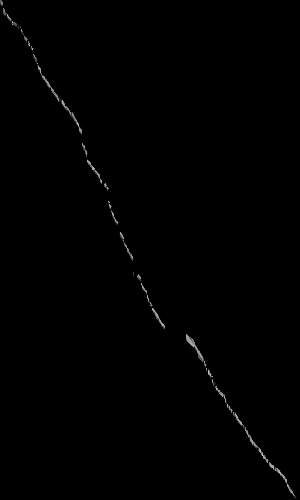

In [23]:
def load_images_from_drive(folder_path):
    images = []
    for i in range(1, 749):  # Assuming the images are named 'top_view_frame_i.png' where i ranges from 1 to 747
        filename = f'top_view_frame_{i}.png'
        img_path = os.path.join(folder_path, filename)

        if os.path.exists(img_path):
            img = cv2.imread(img_path)
            images.append(img)
        else:
            print(f"Image {filename} not found.")

    return images

def stitch_images_vertically(images):
    if len(images) == 0:
        print("No images found.")
        return None

    height, width, _ = images[0].shape
    panorama = images[0].copy()

    for i in range(1, len(images)):
        panorama = cv2.vconcat([panorama, images[i]])

    return panorama

def resize_and_display(image, target_width=500, target_height=1000):
    dim = (target_width, target_height)
    resized_image = cv2.resize(image, dim, interpolation=cv2.INTER_AREA)

    # Display the resized image using matplotlib
    plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

if __name__ == "__main__":
    # Set the folder path
    folder_path = '/content/drive/My Drive/Colab Notebooks/CV proj/topviews'

    # Load images from the specified folder
    images = load_images_from_drive(folder_path)

    # Stitch images vertically
    panorama = stitch_images_vertically(images)


    if panorama is not None:
        # Resize the panorama for display
        resize_and_display(panorama)

        # Save the resized panorama
        output_path = '/content/drive/My Drive/Colab Notebooks/CV proj/panaroma/panorama.jpg'
        cv2.imwrite(output_path, panorama)

        print(f"Panorama saved to {output_path}")

In [ ]:
def load_images_from_drive(folder_path):
    images = []
    for i in range(1, 748):  # Assuming the images are named 'top_view_frame_i.png' where i ranges from 1 to 747
        filename = f'frame_{i}.png'
        img_path = os.path.join(folder_path, filename)

        if os.path.exists(img_path):
            img = cv2.imread(img_path)
            images.append(img)
        else:
            print(f"Image {filename} not found.")

    return images

def save_video(frames, output_path, fps=30):
    height, width, _ = frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    video_writer = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    for frame in frames:
        video_writer.write(frame)

    video_writer.release()

if __name__ == "__main__":
    # Set the folder path
    folder_path = '/content/drive/My Drive/Colab Notebooks/CV proj/framef'

    # Load images from the specified folder
    images = load_images_from_drive(folder_path)

    if images:
        # Save each frame individually in sequence as a video
        output_path = '/content/drive/My Drive/Colab Notebooks/CV proj/sourcevid.mp4'
        save_video(images, output_path)

        print(f"Video saved to {output_path}")

Video saved to /content/drive/My Drive/Colab Notebooks/CV proj/sourcevid.mp4


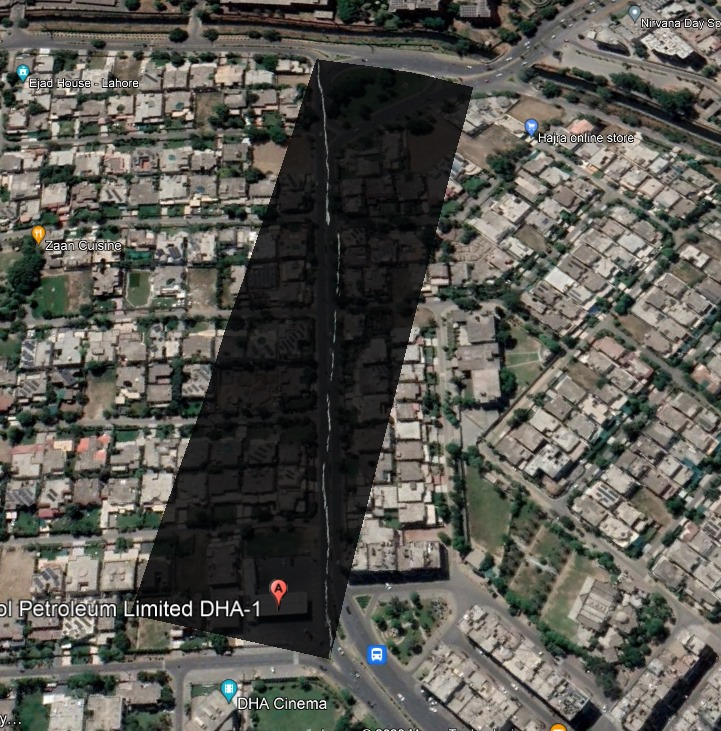

In [24]:
import cv2
from google.colab.patches import cv2_imshow

# Define the image path
image_path = '/content/drive/My Drive/Colab Notebooks/CV proj/overlay.jpg'

# Read the image using cv2
image = cv2.imread(image_path)

# Display the image
cv2_imshow(image)

In [30]:
import cv2
import numpy as np

# Function to calculate Euclidean distance between two points
def euclidean_distance(point1, point2):
    return np.linalg.norm(np.array(point1) - np.array(point2))

# Function to calculate mean Euclidean distance
def mean_distance(point_pairs):
    distances = [euclidean_distance(pair[0], pair[1]) for pair in point_pairs]
    return np.mean(distances)

# Function to calculate percentage error
def percentage_error(actual_distance, offset_distance):
    return (offset_distance / actual_distance) * 100

# Function to scale pixel distance to real-world distance in feet
def pixel_to_feet(pixel_distance, scale_factor):
    return pixel_distance * scale_factor

def pixel_to_mm(pixel_distance, pixel_to_mm_conversion):
    return pixel_distance * pixel_to_mm_conversion

# Define the image path
image_path = '/content/drive/My Drive/Colab Notebooks/CV proj/map.jpg'

# Read the image using cv2
image = cv2.imread(image_path)

# Define the four pairs of points (actual position, offset)
point_pairs = [
    ((321, 539), (325, 539)),
    ((320, 487), (322, 487)),
    ((323, 641), (329, 643)),
    ((315, 66), (317, 64)),
]

# Calculate mean Euclidean distance
mean_dist_pixels = mean_distance(point_pairs)

# Provided scale: 9.8 feet in the real world is around 11 pixels on the image
scale_factor = 9.8 / 11

pixel_to_mm_conversion = 271.55
mean_dist_mm = pixel_to_mm(mean_dist_pixels, pixel_to_mm_conversion)

# Scale pixel distance to real-world distance in feet
real_world_distance = pixel_to_mm(mean_dist_pixels, pixel_to_mm_conversion) * scale_factor

# Calculate percentage error
percentage_err = percentage_error(525600, mean_dist_pixels)

# Display results
print(f"Mean Euclidean Distance: {mean_dist_pixels} pixels")
print(f"Mean Euclidean Distance in Millimeters: {mean_dist_mm} mm")
# print(f"Real-world Distance: {real_world_distance} feet")
print(f"Percentage Error: {percentage_err}%")

Mean Euclidean Distance: 3.7882456112707374 pixels
Mean Euclidean Distance in Millimeters: 1028.6980957405688 mm
Percentage Error: 0.0007207468819008252%
